In [286]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import os
import requests
from requests.structures import CaseInsensitiveDict
from geojson import Feature, Point, FeatureCollection
from dotenv import find_dotenv, load_dotenv
import sqlite3
from pathlib import Path
from pandas import json_normalize
import json
import plotly.express as px
from typing import List, Dict
env_loc = find_dotenv('.env')
load_dotenv(env_loc)

True

In [363]:
geoapify_key = os.environ.get('GEOAPIFY_KEY')

def geoapify_geocode(address_text: str = 'Finsbury Park Station', country: str = 'uk'):
    url = f'https://api.geoapify.com/v1/geocode/search?text={address_text}&apiKey={geoapify_key}&filter=countrycode:{country}'
    headers = CaseInsensitiveDict()
    headers["Accept"] = "application/json"
    response = requests.get(url, headers=headers)
    return response.json()

def geojson_to_geodataframe(geojson: dict, crs: int = 4326):
    collection = FeatureCollection(geojson)
    gdf = gpd.GeoDataFrame.from_features(collection['features']).set_crs(epsg=crs)
    return gdf

def address_to_geodataframe(address_text: str = 'Finsbury Park Station', country: str = 'gb', crs: int = 4326):
    geojson = geoapify_geocode(address_text=address_text, country=country)
    gdf = geojson_to_geodataframe(geojson, crs=crs)
    return gdf

def get_isoline(lat: float, lon: float, type: str = 'time', mode: str = 'walk', range: int = 1000):
    url = f'https://api.geoapify.com/v1/isoline?lat={lat}&lon={lon}&type={type}&mode={mode}&range={range}&apiKey={geoapify_key}'
    headers = CaseInsensitiveDict()
    headers["Accept"] = "application/json"
    response = requests.get(url, headers=headers)
    return response.json()

def get_isoline_from_address(address: str, country: str = 'gb', crs: int = 4326, mode: str = 'drive',
                            traveltime_seconds: int = 1800):
    '''
    Parameters:
    address (str) - 
    country (str) - 
    crs (int) - 
    mode (str) - 
    traveltime_seconds (int) - 
    ___________
    Returns:
    point geodataframe:
    polygon geodataframe:
    '''
    gdf = address_to_geodataframe(address_text=address, country=country, crs=crs).iloc[0]
    lat, lon = gdf['lat'], gdf['lon']
    iso = get_isoline(lat=lat, lon=lon, mode=mode, range=traveltime_seconds)
    isoline_gdf = geojson_to_geodataframe(iso)
    return gdf, isoline_gdf

def travel_time_payload(overlay_gdf: object, address: str, mode: str = 'walk', range: int = 1000,
                       weighted_columns: List = None):
    point_df, travel_df = get_isoline_from_address(address, mode=mode, traveltime_seconds=range)
    overlay_df = gpd.overlay(travel_df, overlay_gdf, how='intersection')
    # Add weighted measure columns
    if weighted_columns:
        for col in weighted_columns:
            overlay_df[f'weighted_{col[0]}'] = (overlay_df[col[1]] / overlay_df[col[1]].sum()) * overlay_df[col[0]]
    return point_df, travel_df, overlay_df

def map_travel_boundaries(payload, zoom_level: int = 10, show: bool = True):
    df = payload[2].drop(labels='geometry',axis=1)
    geojson = json.loads(payload[2].to_json())
    lat = payload[0]['lat']
    lon = payload[0]['lon']

    print(f'Total Population: {round(df.total_population.sum(),-2):,.0f}\n'
         f'Median Age (weighted): {df.weighted_median_age.sum():,.0f}\n'
         f'Average Age (weighted): {df.weighted_mean_age.sum():,.0f}')
    fig = px.choropleth_mapbox(df, geojson=geojson, color="total_population",
                               locations="Ward Code", featureidkey="properties.Ward Code",
                               center={"lat": lat, "lon":lon},
                               hover_data=['Ward Name'],
                               mapbox_style="carto-positron", zoom=zoom_level,opacity=0.5)
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    if show:
        fig.show()
        return fig
    else:
        return fig
    
def address_to_travel_map(overlay_gdf: object, address: str, mode: str = 'drive', range: int = 1000,
                       weighted_columns: List = None, show_map: bool = True, zoom_level: int = 10):
    payload = travel_time_payload(overlay_gdf=overlay_gdf, address=address, mode=mode, range=range,
                                 weighted_columns=weighted_columns)
    fig, map_travel_boundaries(payload=payload, zoom_level=zoom_level, show=show_map)
    return payload, fig

In [364]:
geo = address_to_travel_map(gdf, 'London Bridge', mode='bicycle',
                            weighted_columns=[('mean_age','total_population'),
                                              ('median_age','total_population')])

Total Population: 900,100
Median Age (weighted): 32
Average Age (weighted): 35


In [332]:
geo[0][2]

,lat,lon,mode,type,range,id,wd20cd,wd20nm,total_population,mean_age,median_age,country,prediction,weighted_mean_age,weighted_median_age,geometry
0,51.500841,-0.142988,walk,time,1020,3455b5eb35591857bc4c53b450c6679e,E05000633,Churchill,11071.0,37.504471,36.0,England,0.0,0.005688,0.006734,"POLYGON ((-0.14916 51.49136, -0.14930 51.49153..."
1,51.500841,-0.142988,walk,time,1020,3455b5eb35591857bc4c53b450c6679e,E05000637,Knightsbridge and Belgravia,11746.0,37.848119,36.0,England,0.0,0.006034,0.007145,"POLYGON ((-0.15099 51.49268, -0.15110 51.49273..."
2,51.500841,-0.142988,walk,time,1020,3455b5eb35591857bc4c53b450c6679e,E05000644,St James's,12535.0,41.650897,41.0,England,0.0,0.006440,0.008683,"POLYGON ((-0.14172 51.50711, -0.14158 51.50684..."
3,51.500841,-0.142988,walk,time,1020,3455b5eb35591857bc4c53b450c6679e,E05000645,Tachbrook,9765.0,40.518075,37.0,England,0.0,0.005017,0.006105,"POLYGON ((-0.13722 51.49238, -0.13748 51.49234..."
4,51.500841,-0.142988,walk,time,1020,3455b5eb35591857bc4c53b450c6679e,E05000646,Vincent Square,12509.0,39.505156,38.0,England,0.0,0.006426,0.008031,"POLYGON ((-0.13352 51.49382, -0.13378 51.49364..."
5,51.500841,-0.142988,walk,time,1020,3455b5eb35591857bc4c53b450c6679e,E05000647,Warwick,10540.0,39.052941,36.0,England,0.0,0.005415,0.006411,"POLYGON ((-0.13843 51.49202, -0.13881 51.49184..."
6,51.500841,-0.142988,walk,time,1020,3455b5eb35591857bc4c53b450c6679e,E05000649,West End,13579.0,39.500184,37.0,England,0.0,0.006976,0.008489,"POLYGON ((-0.15114 51.50451, -0.15099 51.50449..."


In [ ]:
# Predictive model to fill gaps in population data at ward level
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn import metrics

pred_df = wards_test
feature_cols = ['long','lat','st_areashape','st_lengthshape','england','wales']
target_col = 'mean_age'

X = pred_df[feature_cols]
y = pred_df[target_col]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=1)

reg = KNeighborsRegressor(n_neighbors=25)

model = reg.fit(X_train, y_train)

#Predict the response for test dataset
y_pred = model.predict(X_test)

# Iterate over rows in missing dataset to populate
predictions = []
for _, row in wards_missing.iterrows():
    features = row[feature_cols].values.reshape(1,-1)
    pred = model.predict(features)
    predictions.append(pred[0])

In [365]:
db_file = Path('../geocoder2/data/database.db')

def dict_factory(cursor, row):
    d = {}
    for idx,col in enumerate(cursor.description):
        d[col[0]] = row[idx]
    return d

connection = sqlite3.connect(db_file)
connection.row_factory = dict_factory

# Estable database connection
cursor = connection.cursor()
def sql_to_df(table_name: str, connection: object):
    request = connection.execute(f'SELECT * FROM {table_name}')
    rows = request.fetchall()
    connection.close()
    df = json_normalize(rows)
    return df

def sql_query(query: str, connection: object):
    request = connection.execute(query)
    rows = request.fetchall()
    df = json_normalize(rows)
    return df



In [366]:
ward_pop = sql_to_df('ward_population_projections_full_2019', connection=connection).iloc[:,1:].drop(columns=['wd20nm'])
ward_pop

,wd20cd,total_population,mean_age,median_age,country,prediction
0,E05000026,15770.00,30.406785,31.00,England,0
1,E05000027,10948.00,33.865546,33.00,England,0
2,E05000028,15261.00,32.307581,32.00,England,0
3,E05000029,11424.00,35.515144,34.00,England,0
4,E05000030,11584.00,37.096081,35.00,England,0
...,...,...,...,...,...,...
7994,E05013208,6379.12,42.123138,42.80,England,1
7995,E05013209,9124.00,40.968323,41.36,England,1
7996,E05013210,8182.56,40.645736,40.94,England,1
7997,E05013211,8004.48,40.117419,40.00,England,1


In [334]:
ward_pop = sql_to_df('ward_population_projections_full_2019', connection=connection).iloc[:,1:].drop(columns=['wd20nm'])
wards_api = requests.get('https://opendata.arcgis.com/datasets/62bfaabbe3e24a359fc36b34d7fe8ac8_0.geojson')
wards_shp = geojson_to_geodataframe(wards_api.json()).iloc[:,:4].drop(columns='objectid')
gdf = wards_shp.merge(ward_pop, on='wd20cd', how='left')
gdf = gdf[(gdf.country == 'England') | (gdf.country == 'Wales')]
gdf = gdf.rename(columns={'wd20cd':'Ward Code','wd20nm':'Ward Name'})

In [322]:
address = travel_time_overlay(gdf, '161 Queens Drive, London, N4 2AR', mode='drive', range=900,
                             weighted_columns=[('mean_age','total_population'),
                                              ('median_age','total_population')])

In [323]:
address[2]

,lat,lon,mode,type,range,id,wd20cd,wd20nm,total_population,mean_age,median_age,country,prediction,weighted_mean_age,weighted_median_age,geometry
0,51.562514,-0.096807,drive,time,900,3ed44365937b57e0b72d18a064c31f98,E05000043,Brunswick Park,16674.0,40.168706,41.0,England,0.0,0.276953,0.282685,"MULTIPOLYGON (((-0.15269 51.62386, -0.15246 51..."
1,51.562514,-0.096807,drive,time,900,3ed44365937b57e0b72d18a064c31f98,E05000045,Childs Hill,22502.0,37.328726,35.5,England,0.0,0.347331,0.330315,"MULTIPOLYGON (((-0.18450 51.56730, -0.18467 51..."
2,51.562514,-0.096807,drive,time,900,3ed44365937b57e0b72d18a064c31f98,E05000047,Coppetts,18837.0,37.442427,37.0,England,0.0,0.291645,0.288199,"MULTIPOLYGON (((-0.15982 51.60877, -0.15981 51..."
3,51.562514,-0.096807,drive,time,900,3ed44365937b57e0b72d18a064c31f98,E05000049,East Finchley,17591.0,38.352453,37.0,England,0.0,0.278973,0.269136,"POLYGON ((-0.15735 51.60390, -0.15742 51.60390..."
4,51.562514,-0.096807,drive,time,900,3ed44365937b57e0b72d18a064c31f98,E05000051,Finchley Church End,17571.0,39.903022,39.0,England,0.0,0.289922,0.283361,"POLYGON ((-0.22519 51.59943, -0.22509 51.59924..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,51.562514,-0.096807,drive,time,900,3ed44365937b57e0b72d18a064c31f98,E05011095,Borough & Bankside,10858.0,34.291951,31.0,England,0.0,0.153965,0.139184,"POLYGON ((-0.10032 51.50851, -0.10032 51.50803..."
176,51.562514,-0.096807,drive,time,900,3ed44365937b57e0b72d18a064c31f98,E05011114,St George's,6969.0,34.479696,31.0,England,0.0,0.099360,0.089333,"POLYGON ((-0.10047 51.50046, -0.10068 51.50038..."
177,51.562514,-0.096807,drive,time,900,3ed44365937b57e0b72d18a064c31f98,E05011238,Churchfields,15693.0,37.859237,38.0,England,0.0,0.245673,0.246586,"POLYGON ((0.01264 51.59615, 0.01270 51.59602, ..."
178,51.562514,-0.096807,drive,time,900,3ed44365937b57e0b72d18a064c31f98,E05011254,Wanstead Park,8066.0,40.123233,41.0,England,0.0,0.133824,0.136748,"MULTIPOLYGON (((0.01858 51.57004, 0.01855 51.5..."


In [324]:
def map_travel_boundaries(payload, zoom_level: int = 10):
    df = payload[2].drop(labels='geometry',axis=1)
    geojson = json.loads(payload[2].to_json())
    lat = payload[0]['lat']
    lon = payload[0]['lon']

    print(f'Total Population: {df.total_population.sum():,.0f}\n'
         f'Median Age (weighted): {df.weighted_median_age.sum()}\n'
         f'Average Age (weighted): {df.weighted_mean_age.sum()}')
    fig = px.choropleth_mapbox(df, geojson=geojson, color="total_population",
                               locations="wd20cd", featureidkey="properties.wd20cd",
                               center={"lat": lat, "lon":lon},
                               hover_data=['wd20nm'],
                               mapbox_style="carto-positron", zoom=zoom_level,opacity=0.5)
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.show()

In [326]:
map_travel_boundaries(address, zoom_level=10)

Total Population: 2,418,362
Median Age (weighted): 34.11911113641382
Average Age (weighted): 35.613843701227495


In [155]:
to_map = gdf[(gdf.country == 'England') | (gdf.country == 'Wales')][['wd20cd','wd20nm_x','total_population',
                                                           'median_age','mean_age','country','geometry']]

<AxesSubplot:>

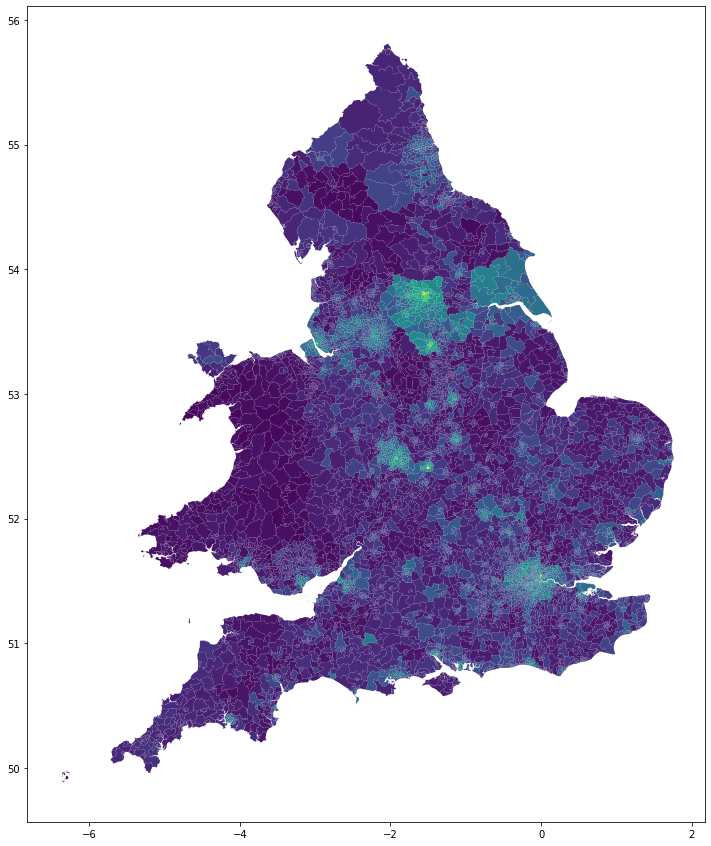

In [159]:
to_map.plot(column='total_population', figsize=(15,15))

In [188]:
overlay = travel_time_wards(address='Bristol, Wales',mode='truck',range=3600)

<AxesSubplot:>

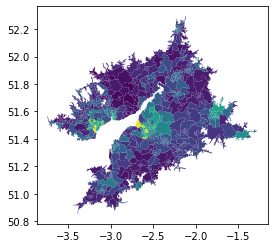

In [189]:
overlay[0].plot(column='total_population')

In [169]:
overlay[0].total_population.sum()

2450833.3200000003

In [ ]:
gdf.columns

In [24]:
wards_csv = gdf[['wd20cd','wd20nm','bng_e','bng_n','long','lat','st_areashape','st_lengthshape','total_population',
    'mean_age','median_age']]

In [36]:
countries = []
for _, row in wards_csv.iterrows():
    if row['wd20cd'].startswith('E'):
        countries.append('England')
    elif row['wd20cd'].startswith('W'):
        countries.append('Wales')
    elif row['wd20cd'].startswith('S'):
        countries.append('Scotland')
    elif row['wd20cd'].startswith('N'):
        countries.append('Northern Ireland')

In [58]:
wards_missing = wards_csv[(wards_csv.country == 'England') | (wards_csv.country == 'Wales')][wards_csv.total_population.isnull()]
wards_missing['country_binary'] = [ 1 if x=='England' else 0 for x in wards_missing.country]

<ipython-input-58-4927ab744908>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  wards_missing = wards_csv[(wards_csv.country == 'England') | (wards_csv.country == 'Wales')][wards_csv.total_population.isnull()]


In [108]:
wards_missing['england'] = [ 1 if x=='England' else 0 for x in wards_missing.country]

In [75]:
wards_test['wales'] = [ 0 if x=='England' else 1 for x in wards_test.country]

In [76]:
wards_test.head()

,wd20cd,wd20nm,bng_e,bng_n,long,lat,st_areashape,st_lengthshape,total_population,mean_age,median_age,country,country_binary,england,wales
0,E05000026,Abbey,544433,184376,0.081276,51.539810,1.250363e+06,7852.899752,15770.0,30.406785,31.0,England,1,1,0
1,E05000027,Alibon,549247,185196,0.150987,51.545921,1.355410e+06,6246.786205,10948.0,33.865546,33.0,England,1,1,0
2,E05000028,Becontree,546860,185870,0.116869,51.552608,1.291759e+06,6278.989501,15261.0,32.307581,32.0,England,1,1,0
3,E05000029,Chadwell Heath,548266,189340,0.138596,51.583420,3.386256e+06,9512.974945,11424.0,35.515144,34.0,England,1,1,0
4,E05000030,Eastbrook,550775,186271,0.173467,51.555180,3.449235e+06,8839.042550,11584.0,37.096081,35.0,England,1,1,0


In [135]:
wards_missing['mean_age'] = predictions

In [140]:
wards_missing_filled = wards_missing[['wd20cd','wd20nm','total_population','mean_age','median_age','country']]
wards_missing_filled['prediction'] = True
wards_test['prediction'] = False

<ipython-input-140-9db50f4ac74f>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  wards_missing_filled['prediction'] = True


In [142]:
wards_test[['wd20cd','wd20nm','total_population','mean_age','median_age','country','prediction']].append(wards_missing_filled).to_csv('data/wards/ward_population_projections_full_2019.csv')

In [96]:
def kneighbors_regression(n=5):
    pred_df = wards_test
    feature_cols = ['long','lat','st_areashape','st_lengthshape','england','wales']
    target_col = 'total_population'

    X = pred_df[feature_cols]
    y = pred_df[target_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=1)

    reg = KNeighborsRegressor(n_neighbors=n)

    model = reg.fit(X_train, y_train)

    #Predict the response for test dataset
    y_pred = model.predict(X_test)

    y_train_pred = model.predict(X_train)

    return np.sqrt(metrics.mean_squared_error(y_train, y_train_pred))

In [97]:
errors = []
for i in range(10,200):
    accuracy = kneighbors_regression(i)
    errors.append(accuracy)

<AxesSubplot:>

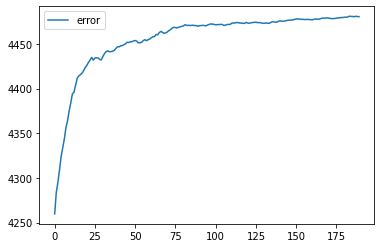

In [100]:
errors_df = pd.DataFrame({'error':errors})
errors_df.plot()

In [102]:
import numpy as np
y_train_pred = model.predict(X_train)

np.sqrt(metrics.mean_squared_error(y_train, y_train_pred))

4414.1196585877315

In [103]:
np.sqrt(metrics.mean_squared_error(y_test, y_pred))

4481.252523838999

In [81]:
wards_test.total_population.mean()

7397.980028346862

In [90]:
geojson = gdf.to_json()

In [91]:
df = gdf.drop(labels='geometry', axis=1)
df.head()

,wd20cd,wd20nm,Unnamed: 0,Ward Code 1,total_population,mean_age,median_age,Under 10,10-17,18-25,26-30,31-35,36-40,41-50,51-60,61-70,71-80,81-90,90+
0,E05000026,Abbey,0,E05000026,15770.0,30.406785,31.0,2829.0,1869.0,1416.0,1589.0,1986.0,1659.0,2051.0,1196.0,666.0,333.0,176.0,15770.0
1,E05000027,Alibon,1,E05000027,10948.0,33.865546,33.0,1724.0,1438.0,1049.0,808.0,875.0,821.0,1576.0,1350.0,686.0,367.0,254.0,10948.0
2,E05000028,Becontree,2,E05000028,15261.0,32.307581,32.0,2532.0,2178.0,1487.0,1116.0,1442.0,1260.0,2038.0,1570.0,898.0,467.0,273.0,15261.0
3,E05000029,Chadwell Heath,3,E05000029,11424.0,35.515144,34.0,1709.0,1571.0,1037.0,814.0,909.0,787.0,1471.0,1242.0,818.0,599.0,467.0,11424.0
4,E05000030,Eastbrook,4,E05000030,11584.0,37.096081,35.0,1525.0,1294.0,1366.0,882.0,836.0,715.0,1406.0,1510.0,909.0,646.0,495.0,11584.0


In [92]:
gdf.head()#.plot(column='All Ages', cmap='viridis')

,geometry,wd20cd,wd20nm,Unnamed: 0,Ward Code 1,total_population,mean_age,median_age,Under 10,10-17,18-25,26-30,31-35,36-40,41-50,51-60,61-70,71-80,81-90,90+
0,"MULTIPOLYGON (((0.08006 51.54477, 0.07796 51.5...",E05000026,Abbey,0,E05000026,15770.0,30.406785,31.0,2829.0,1869.0,1416.0,1589.0,1986.0,1659.0,2051.0,1196.0,666.0,333.0,176.0,15770.0
1,"POLYGON ((0.15638 51.55102, 0.15313 51.55140, ...",E05000027,Alibon,1,E05000027,10948.0,33.865546,33.0,1724.0,1438.0,1049.0,808.0,875.0,821.0,1576.0,1350.0,686.0,367.0,254.0,10948.0
2,"POLYGON ((0.12716 51.55561, 0.12768 51.55684, ...",E05000028,Becontree,2,E05000028,15261.0,32.307581,32.0,2532.0,2178.0,1487.0,1116.0,1442.0,1260.0,2038.0,1570.0,898.0,467.0,273.0,15261.0
3,"POLYGON ((0.14821 51.59897, 0.14660 51.59944, ...",E05000029,Chadwell Heath,3,E05000029,11424.0,35.515144,34.0,1709.0,1571.0,1037.0,814.0,909.0,787.0,1471.0,1242.0,818.0,599.0,467.0,11424.0
4,"POLYGON ((0.18515 51.56478, 0.18518 51.56551, ...",E05000030,Eastbrook,4,E05000030,11584.0,37.096081,35.0,1525.0,1294.0,1366.0,882.0,836.0,715.0,1406.0,1510.0,909.0,646.0,495.0,11584.0


In [12]:
travel_time = get_isoline_from_address('Buckingham Palace')

In [13]:
import folium
travel_time[1]

,geometry,lat,lon,mode,type,range,id
0,"MULTIPOLYGON (((-0.23875 51.73908, -0.23876 51...",51.500841,-0.142988,drive,time,1800,54545bd0a926a441ce101b28940768c5


In [15]:
travel_wards = gpd.overlay(travel_time[1],gdf, how='intersection')

In [63]:
def travel_time_wards(address: str = 'Finsbury Park', mode: str = 'walk', range: int = 1000):
    travel_df = get_isoline_from_address(address, mode=mode, traveltime_seconds=range)
    travel_wards = gpd.overlay(travel_df[1], gdf, how='intersection')
    return travel_wards, travel_df[1]

In [72]:
travel_df = travel_time_wards(mode='walk',range=900)
#travel_df[0]

In [99]:
travel_df[0][['total_population','median_age','mean_age','Under 10', 
              '10-17', '18-25', '26-30', '31-35', '36-40',
              '41-50', '51-60', '61-70', '71-80', '81-90']].sum()

total_population    1.572587e+07
median_age          6.231450e+04
mean_age            6.192343e+04
Under 10            1.880897e+06
10-17               1.697584e+06
18-25               1.457248e+06
26-30               1.196264e+06
31-35               1.274805e+06
36-40               1.241220e+06
41-50               2.165905e+06
51-60               1.946870e+06
61-70               1.340834e+06
71-80               9.572140e+05
81-90               5.670280e+05
dtype: float64

In [170]:
import folium
m = folium.Map(location=[51.56,-0.1], zoom_start=13)
#folium.GeoJson(gdf).add_to(m)
#folium.GeoJson(travel_df[0]).add_to(m)
folium.GeoJson(overlay[0]).add_to(m)
m

In [117]:
tt_df = geojson_to_geodataframe(travel_time)

AttributeError: No geometry data set yet (expected in column 'geometry'.)

In [185]:
overlay[1]['lon'].values[0]

-0.1064144

Total Population: 4,690,492


In [86]:
json.loads(geojson)

{'type': 'FeatureCollection',
 'features': [{'id': '0',
   'type': 'Feature',
   'properties': {'10-17': 1605.0,
    '18-29': 2686.0,
    '30-39': 3694.0,
    '40-49': 2169.0,
    '50-59': 1253.0,
    '60-69': 712.0,
    '70-79': 356.0,
    '80+': 202.0,
    'All Ages': 15770.0,
    'LA Code (2019 boundaries)': 'E09000002',
    'LA Code (2020 boundaries)': 'E09000002',
    'LA name (2019 boundaries)': 'Barking and Dagenham',
    'LA name (2020 boundaries)': 'Barking and Dagenham',
    'Under 10': 3093.0,
    'Unnamed: 0': 0,
    'Ward Code 1': 'E05000026',
    'Ward Name 1': 'Abbey',
    'wd20cd': 'E05000026',
    'wd20nm': 'Abbey'},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[0.080063896122735, 51.544772355844444],
       [0.077960041034707, 51.5440520016689],
       [0.077493984221171, 51.544573514488384],
       [0.077033061451772, 51.544379502885285],
       [0.076809971289619, 51.54458491428844],
       [0.075548908011019, 51.544011219225986],
       [0.07195709

In [42]:
ward_codes = gdf['wd20cd'].unique()
for ward in ward_codes:
    print(ward)

E05000026
E05000027
E05000028
E05000029
E05000030
E05000031
E05000032
E05000033
E05000034
E05000035
E05000036
E05000037
E05000038
E05000039
E05000040
E05000041
E05000042
E05000043
E05000044
E05000045
E05000046
E05000047
E05000048
E05000049
E05000050
E05000051
E05000052
E05000053
E05000054
E05000055
E05000056
E05000057
E05000058
E05000059
E05000060
E05000061
E05000062
E05000063
E05000085
E05000086
E05000087
E05000088
E05000089
E05000090
E05000091
E05000092
E05000093
E05000094
E05000095
E05000096
E05000097
E05000098
E05000099
E05000100
E05000101
E05000102
E05000103
E05000104
E05000105
E05000106
E05000107
E05000108
E05000109
E05000110
E05000111
E05000112
E05000113
E05000114
E05000115
E05000116
E05000117
E05000118
E05000119
E05000120
E05000121
E05000122
E05000123
E05000124
E05000125
E05000126
E05000127
E05000128
E05000129
E05000130
E05000131
E05000132
E05000133
E05000134
E05000135
E05000136
E05000137
E05000138
E05000139
E05000140
E05000141
E05000142
E05000143
E05000144
E05000145
E05000170


E05005764
E05005765
E05005766
E05005767
E05005768
E05005769
E05005770
E05005771
E05005772
E05005773
E05005774
E05005775
E05005776
E05005777
E05005778
E05005779
E05005780
E05005781
E05005782
E05005783
E05005784
E05005785
E05005786
E05005787
E05005788
E05005789
E05005790
E05005791
E05005792
E05005793
E05005794
E05005795
E05005796
E05005797
E05005798
E05005799
E05005800
E05005965
E05005966
E05005971
E05005972
E05005973
E05005974
E05005975
E05005982
E05005986
E05005987
E05005988
E05005989
E05005991
E05005992
E05005993
E05005994
E05005995
E05005996
E05005998
E05005999
E05006000
E05006001
E05006002
E05006003
E05006027
E05006028
E05006029
E05006030
E05006031
E05006032
E05006033
E05006034
E05006035
E05006036
E05006037
E05006038
E05006039
E05006040
E05006041
E05006042
E05006043
E05006044
E05006045
E05006046
E05006047
E05006048
E05006049
E05006050
E05006051
E05006052
E05006053
E05006191
E05006198
E05006203
E05006206
E05006297
E05006298
E05006299
E05006300
E05006301
E05006302
E05006303
E05006304


E05010524
E05010525
E05010526
E05010527
E05010528
E05010529
E05010530
E05010531
E05010532
E05010533
E05010550
E05010551
E05010552
E05010553
E05010554
E05010555
E05010556
E05010557
E05010558
E05010559
E05010560
E05010561
E05010562
E05010563
E05010564
E05010565
E05010566
E05010567
E05010604
E05010605
E05010606
E05010607
E05010608
E05010609
E05010610
E05010611
E05010612
E05010613
E05010614
E05010615
E05010616
E05010617
E05010618
E05010619
E05010620
E05010621
E05010622
E05010623
E05010624
E05010625
E05010626
E05010627
E05010628
E05010629
E05010630
E05010631
E05010632
E05010633
E05010634
E05010635
E05010636
E05010637
E05010638
E05010639
E05010640
E05010641
E05010642
E05010643
E05010644
E05010645
E05010646
E05010647
E05010648
E05010649
E05010650
E05010651
E05010652
E05010653
E05010654
E05010655
E05010656
E05010657
E05010658
E05010659
E05010660
E05010661
E05010662
E05010663
E05010664
E05010665
E05010666
E05010667
E05010668
E05010669
E05010670
E05010671
E05010672
E05010673
E05010674
E05010675


E05012724
E05012725
E05012726
E05012727
E05012728
E05012729
E05012730
E05012731
E05012732
E05012733
E05012734
E05012735
E05012736
E05012737
E05012738
E05012739
E05012740
E05012741
E05012742
E05012743
E05012744
E05012745
E05012746
E05012747
E05012748
E05012749
E05012750
E05012751
E05012752
E05012753
E05012754
E05012755
E05012756
E05012757
E05012758
E05012759
E05012760
E05012761
E05012762
E05012763
E05012764
E05012765
E05012766
E05012767
E05012768
E05012769
E05012770
E05012771
E05012772
E05012773
E05012774
E05012775
E05012776
E05012777
E05012778
E05012779
E05012780
E05012781
E05012782
E05012783
E05012784
E05012785
E05012786
E05012787
E05012788
E05012789
E05012790
E05012791
E05012792
E05012793
E05012794
E05012795
E05012796
E05012797
E05012798
E05012799
E05012800
E05012801
E05012802
E05012803
E05012804
E05012805
E05012806
E05012807
E05012808
E05012809
E05012810
E05012811
E05012812
E05012813
E05012814
E05012815
E05012816
E05012817
E05012818
E05012819
E05012820
E05012821
E05012822
E05012823


In [205]:
ward_pop

,,wd20cd,wd20nm,total_population,mean_age,median_age,country,prediction
7761,3542,E05009289,Aldgate,3793.32,38.271950,36.96,England,1
7762,3543,E05009290,Bassishaw,3793.32,38.271950,36.96,England,1
7763,3544,E05009291,Billingsgate,3793.32,38.271950,36.96,England,1
7764,3546,E05009293,Bread Street,3793.32,38.271950,36.96,England,1
7765,3547,E05009294,Bridge,3793.32,38.271950,36.96,England,1
...,...,...,...,...,...,...,...,...
7994,7142,E05013208,Marsden & Southfield,6379.12,42.123138,42.80,England,1
7995,7143,E05013209,Vivary Bridge,9124.00,40.968323,41.36,England,1
7996,7144,E05013210,Waterside & Horsfield,8182.56,40.645736,40.94,England,1
7997,7145,E05013211,Whitefield & Walverden,8004.48,40.117419,40.00,England,1


In [164]:
pop = pd.read_excel('data/wards/2019_population_projections.xlsx', sheet_name='Mid-2019 Persons', engine='openpyxl', header=4)

/Users/davidbender/Desktop/geocoder2/venv/lib/python3.9/site-packages/openpyxl/worksheet/header_footer.py:48: UserWarning: Cannot parse header or footer so it will be ignored
  warn("""Cannot parse header or footer so it will be ignored""")


In [165]:
pop.head()

,Ward Code 1,Ward Name 1,LA Code (2019 boundaries),LA name (2019 boundaries),LA Code (2020 boundaries),LA name (2020 boundaries),All Ages,0,1,2,...,81,82,83,84,85,86,87,88,89,90+
0,E05000026,Abbey,E09000002,Barking and Dagenham,E09000002,Barking and Dagenham,15770.0,291.0,337.0,331.0,...,29.0,20.0,14.0,17.0,15.0,18.0,13.0,11.0,13.0,26.0
1,E05000027,Alibon,E09000002,Barking and Dagenham,E09000002,Barking and Dagenham,10948.0,168.0,185.0,190.0,...,31.0,21.0,24.0,29.0,26.0,18.0,16.0,26.0,4.0,59.0
2,E05000028,Becontree,E09000002,Barking and Dagenham,E09000002,Barking and Dagenham,15261.0,250.0,273.0,283.0,...,36.0,38.0,23.0,25.0,21.0,24.0,20.0,14.0,13.0,59.0
3,E05000029,Chadwell Heath,E09000002,Barking and Dagenham,E09000002,Barking and Dagenham,11424.0,204.0,195.0,186.0,...,57.0,52.0,50.0,34.0,31.0,32.0,30.0,26.0,26.0,129.0
4,E05000030,Eastbrook,E09000002,Barking and Dagenham,E09000002,Barking and Dagenham,11584.0,180.0,146.0,180.0,...,54.0,56.0,48.0,39.0,26.0,37.0,29.0,29.0,23.0,154.0


In [4]:
all_tables_query = 'SELECT * FROM sqlite_schema'
sql = sql_query(all_tables_query, connection)
sql

,type,name,tbl_name,rootpage,sql
0,table,UK_Wards,UK_Wards,2,"CREATE TABLE ""UK_Wards"" (\n""index"" INTEGER,\n ..."
1,index,ix_UK_Wards_index,UK_Wards,3,"CREATE INDEX ""ix_UK_Wards_index""ON ""UK_Wards"" ..."
2,table,UK_Local_Authorities,UK_Local_Authorities,99,"CREATE TABLE ""UK_Local_Authorities"" (\n""index""..."
3,index,ix_UK_Local_Authorities_index,UK_Local_Authorities,100,"CREATE INDEX ""ix_UK_Local_Authorities_index""ON..."
4,table,UK_Constituencies,UK_Constituencies,104,"CREATE TABLE ""UK_Constituencies"" (\n""index"" IN..."
5,index,ix_UK_Constituencies_index,UK_Constituencies,105,"CREATE INDEX ""ix_UK_Constituencies_index""ON ""U..."
6,table,UK_Election_2019,UK_Election_2019,114,"CREATE TABLE ""UK_Election_2019"" (\n""index"" INT..."
7,index,ix_UK_Election_2019_index,UK_Election_2019,115,"CREATE INDEX ""ix_UK_Election_2019_index""ON ""UK..."
8,table,Postcode_coordinates,Postcode_coordinates,147,CREATE TABLE Postcode_coordinates (postcode TE...
9,table,UK_Wards_Population,UK_Wards_Population,84907,"CREATE TABLE ""UK_Wards_Population"" (\nCode str..."


In [6]:
wards_pop = sql_to_df('Ward_projections_2019', connection)
wards_pop = wards_pop.set_index('Ward Code 1').rename(columns={'90+':'90'})
wards_pop.head()

,index,Ward Name 1,LA Code (2019 boundaries),LA name (2019 boundaries),LA Code (2020 boundaries),LA name (2020 boundaries),All Ages,0,1,2,...,81,82,83,84,85,86,87,88,89,90
Ward Code 1,,,,,,,,,,,,,,,,,,,,,
E05000026,0,Abbey,E09000002,Barking and Dagenham,E09000002,Barking and Dagenham,15770.0,291.0,337.0,331.0,...,29.0,20.0,14.0,17.0,15.0,18.0,13.0,11.0,13.0,26.0
E05000027,1,Alibon,E09000002,Barking and Dagenham,E09000002,Barking and Dagenham,10948.0,168.0,185.0,190.0,...,31.0,21.0,24.0,29.0,26.0,18.0,16.0,26.0,4.0,59.0
E05000028,2,Becontree,E09000002,Barking and Dagenham,E09000002,Barking and Dagenham,15261.0,250.0,273.0,283.0,...,36.0,38.0,23.0,25.0,21.0,24.0,20.0,14.0,13.0,59.0
E05000029,3,Chadwell Heath,E09000002,Barking and Dagenham,E09000002,Barking and Dagenham,11424.0,204.0,195.0,186.0,...,57.0,52.0,50.0,34.0,31.0,32.0,30.0,26.0,26.0,129.0
E05000030,4,Eastbrook,E09000002,Barking and Dagenham,E09000002,Barking and Dagenham,11584.0,180.0,146.0,180.0,...,54.0,56.0,48.0,39.0,26.0,37.0,29.0,29.0,23.0,154.0


In [70]:
#wards_pop = wards_pop.set_index('Ward Code 1')
wards_pop = wards_pop.iloc[:-14, 7:]

In [113]:
wards_pop.iloc[:,26:31]

,26,27,28,29,30
Ward Code 1,,,,,
E05000026,287.0,313.0,331.0,339.0,319.0
E05000027,174.0,149.0,156.0,164.0,165.0
E05000028,199.0,205.0,199.0,239.0,274.0
E05000029,148.0,166.0,159.0,177.0,164.0
E05000030,191.0,160.0,181.0,177.0,173.0
...,...,...,...,...,...
W05001034,21.0,28.0,24.0,21.0,20.0
W05001035,57.0,73.0,66.0,52.0,56.0
W05001036,50.0,60.0,70.0,68.0,82.0


In [116]:
#ward_ages_grouped = wards_pop.copy()
ward_ages_grouped

,0,1,2,3,4,5,6,7,8,9,...,81,82,83,84,85,86,87,88,89,90
Ward Code 1,,,,,,,,,,,,,,,,,,,,,
E05000026,291.0,337.0,331.0,346.0,311.0,335.0,298.0,307.0,273.0,264.0,...,29.0,20.0,14.0,17.0,15.0,18.0,13.0,11.0,13.0,26.0
E05000027,168.0,185.0,190.0,214.0,188.0,199.0,190.0,178.0,212.0,163.0,...,31.0,21.0,24.0,29.0,26.0,18.0,16.0,26.0,4.0,59.0
E05000028,250.0,273.0,283.0,298.0,294.0,279.0,297.0,275.0,283.0,275.0,...,36.0,38.0,23.0,25.0,21.0,24.0,20.0,14.0,13.0,59.0
E05000029,204.0,195.0,186.0,198.0,196.0,184.0,184.0,196.0,166.0,195.0,...,57.0,52.0,50.0,34.0,31.0,32.0,30.0,26.0,26.0,129.0
E05000030,180.0,146.0,180.0,183.0,153.0,197.0,166.0,166.0,154.0,153.0,...,54.0,56.0,48.0,39.0,26.0,37.0,29.0,29.0,23.0,154.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
W05001034,25.0,19.0,20.0,26.0,25.0,23.0,28.0,11.0,27.0,25.0,...,10.0,14.0,9.0,10.0,8.0,9.0,4.0,5.0,0.0,14.0
W05001035,55.0,70.0,48.0,57.0,72.0,66.0,61.0,52.0,60.0,56.0,...,32.0,27.0,29.0,22.0,22.0,15.0,11.0,11.0,3.0,38.0
W05001036,45.0,62.0,54.0,50.0,47.0,61.0,49.0,63.0,44.0,59.0,...,17.0,11.0,18.0,14.0,6.0,17.0,7.0,9.0,4.0,37.0


In [117]:
ward_ages_grouped['Under 10'] = ward_ages_grouped.iloc[:,:9].sum(axis=1)
ward_ages_grouped['10-17'] = ward_ages_grouped.iloc[:,9:18].sum(axis=1)
ward_ages_grouped['18-25'] = ward_ages_grouped.iloc[:,18:26].sum(axis=1)
ward_ages_grouped['26-30'] = ward_ages_grouped.iloc[:,26:31].sum(axis=1)
ward_ages_grouped['31-35'] = ward_ages_grouped.iloc[:,31:36].sum(axis=1)
ward_ages_grouped['36-40'] = ward_ages_grouped.iloc[:,36:41].sum(axis=1)
ward_ages_grouped['41-50'] = ward_ages_grouped.iloc[:,41:51].sum(axis=1)
ward_ages_grouped['51-60'] = ward_ages_grouped.iloc[:,51:61].sum(axis=1)
ward_ages_grouped['61-70'] = ward_ages_grouped.iloc[:,61:71].sum(axis=1)
ward_ages_grouped['71-80'] = ward_ages_grouped.iloc[:,71:81].sum(axis=1)
ward_ages_grouped['81-90'] = ward_ages_grouped.iloc[:,81:91].sum(axis=1)
ward_ages_grouped['90+'] = ward_ages_grouped.iloc[:,91:].sum(axis=1)

In [122]:
ward_ages_grouped = ward_ages_grouped.iloc[:,91:]

In [126]:
ward_ages_grouped = ward_ages_grouped.reset_index()

In [132]:
wards_full = wards_grouped.reset_index().merge(ward_ages_grouped, on='Ward Code 1', how='inner').drop(columns=['age','cumulative_age']).rename(columns={'count':'total_population'})

In [134]:
wards_full.to_csv('data/wards/ward_population_projections_2019.csv')

In [72]:
ward_ages = wards_pop.reset_index().melt(id_vars='Ward Code 1',var_name='age',value_name='count')

In [73]:
ward_ages['age'] = ward_ages['age'].astype('int')

In [74]:
ward_ages['cumulative_age'] = ward_ages['age'] * ward_ages['count']

In [76]:
wards_grouped = ward_ages.groupby(by='Ward Code 1').sum('count')
wards_grouped['mean_age'] = wards_grouped['cumulative_age'] / wards_grouped['count']
wards_grouped

,age,count,cumulative_age,mean_age
Ward Code 1,,,,
E05000026,4095,15770.0,479515.0,30.406785
E05000027,4095,10948.0,370760.0,33.865546
E05000028,4095,15261.0,493046.0,32.307581
E05000029,4095,11424.0,405725.0,35.515144
E05000030,4095,11584.0,429721.0,37.096081
...,...,...,...,...
W05001034,4095,2067.0,87939.0,42.544267
W05001035,4095,4979.0,206646.0,41.503515
W05001036,4095,4194.0,167965.0,40.048879


In [100]:
import numpy as np
def median_age(ward_code):
    df = ward_ages[ward_ages['Ward Code 1'] == str(ward_code)]
    array = []
    for _, row in df.iterrows():
        for i in range(int(row['count'])):
            array.append(row['age'])
    median = np.median(array)
    return median

In [101]:
wards_median = []
for ward in wards_grouped.index:
    try:
        median = median_age(ward)
        wards_median.append(median)
    except Exception as e:
        print(e)

In [103]:
wards_grouped['median_age'] = wards_median

In [106]:
wards_grouped.drop(axis=1, columns=['age','cumulative_age']).reset_index()#.to_csv('data/wards/ward_attributes')

,Ward Code 1,count,mean_age,median_age
0,E05000026,15770.0,30.406785,31.0
1,E05000027,10948.0,33.865546,33.0
2,E05000028,15261.0,32.307581,32.0
3,E05000029,11424.0,35.515144,34.0
4,E05000030,11584.0,37.096081,35.0
...,...,...,...,...
8048,W05001034,2067.0,42.544267,45.0
8049,W05001035,4979.0,41.503515,41.0
8050,W05001036,4194.0,40.048879,39.0
8051,W05001037,1761.0,50.139125,55.0


In [ ]:
'df.iloc[:, -4:-1].sum(axis=1)'
wards_pop['80+'] = wards_pop.iloc[:,88:99].sum(axis=1)

In [ ]:
columns = wards_pop.columns
col_list = ['Ward Code 1','Ward Name 1','LA Code (2019 boundaries)','LA name (2019 boundaries)',
            'LA Code (2020 boundaries)','LA name (2020 boundaries)','All Ages','Under 10','10-17','18-29',
           '30-39','40-49','50-59','60-69','70-79','80+']
ward_attr = wards_pop[col_list]

In [ ]:
def calc_average_age():
    # Multiply each age group by count for total aggregate age
    # Divide total aggregate age by All Ages people count
    
def calc_median_age(column_range):
    # Create an array of each instance of age
    # Calculate the median of the array
    array = []
    for column in column_range:
        for i in range(column):
            array.extend(column)

In [ ]:
for (columnName, columnData) in ward_attr.iloc[:,6:].iteritems():
    print('Column Name : ', columnName)
    print('Column Contents : ', columnData.values)

In [136]:
ward_shp = gpd.read_file('data/shapefiles/wards/Wards__December_2017__Boundaries_in_GB.shp').to_crs(epsg=4326)
ward_shp

,objectid,wd17cd,wd17nm,wd17nmw,bng_e,bng_n,long,lat,st_areasha,st_lengths,geometry
0,1,E05000026,Abbey,None,544434,184378,0.081291,51.539822,1.256363e+06,8051.439523,"MULTIPOLYGON (((0.08092 51.54438, 0.08206 51.5..."
1,2,E05000027,Alibon,None,549247,185196,0.150987,51.545921,1.364443e+06,6353.928980,"POLYGON ((0.15635 51.55102, 0.15642 51.54973, ..."
2,3,E05000028,Becontree,None,546863,185869,0.116912,51.552601,1.288085e+06,6341.644591,"POLYGON ((0.12713 51.55561, 0.12690 51.55526, ..."
3,4,E05000029,Chadwell Heath,None,548266,189340,0.138596,51.583420,3.384194e+06,9603.417390,"POLYGON ((0.14818 51.59896, 0.14811 51.59868, ..."
4,5,E05000030,Eastbrook,None,550774,186272,0.173453,51.555191,3.450577e+06,8987.803946,"POLYGON ((0.18512 51.56479, 0.18515 51.56475, ..."
...,...,...,...,...,...,...,...,...,...,...,...
8664,8665,W05001034,Seven Sisters,Blaendulais,282205,208034,-3.708120,51.758572,1.163967e+07,15815.740477,"POLYGON ((-3.71489 51.77822, -3.71488 51.77821..."
8665,8666,W05001035,Tai-bach,Tai-bach,278526,188941,-3.754750,51.586189,5.534418e+06,13215.494735,"POLYGON ((-3.73213 51.60008, -3.73213 51.59956..."
8666,8667,W05001036,Broughton South,Brychdyn - De,333635,362976,-2.994000,53.159771,3.194520e+06,11983.677493,"POLYGON ((-2.97093 53.16077, -2.97108 53.16050..."
8667,8668,W05001037,Penally,Penalun,211555,200954,-4.726920,51.675659,2.124985e+07,31767.690335,"MULTIPOLYGON (((-4.76166 51.70720, -4.76151 51..."


In [142]:
full_ward_shp = ward_shp.merge(wards_full, left_on='wd17cd', right_on='Ward Code 1',how='left').drop(columns=['objectid',
                                                                                              'wd17nmw',
                                                                                              'bng_e',
                                                                                             'bng_n',
                                                                                             'lat',
                                                                                             'st_areasha',
                                                                                             'st_lengths','long',
                                                                                             'Ward Code 1'])

<AxesSubplot:>

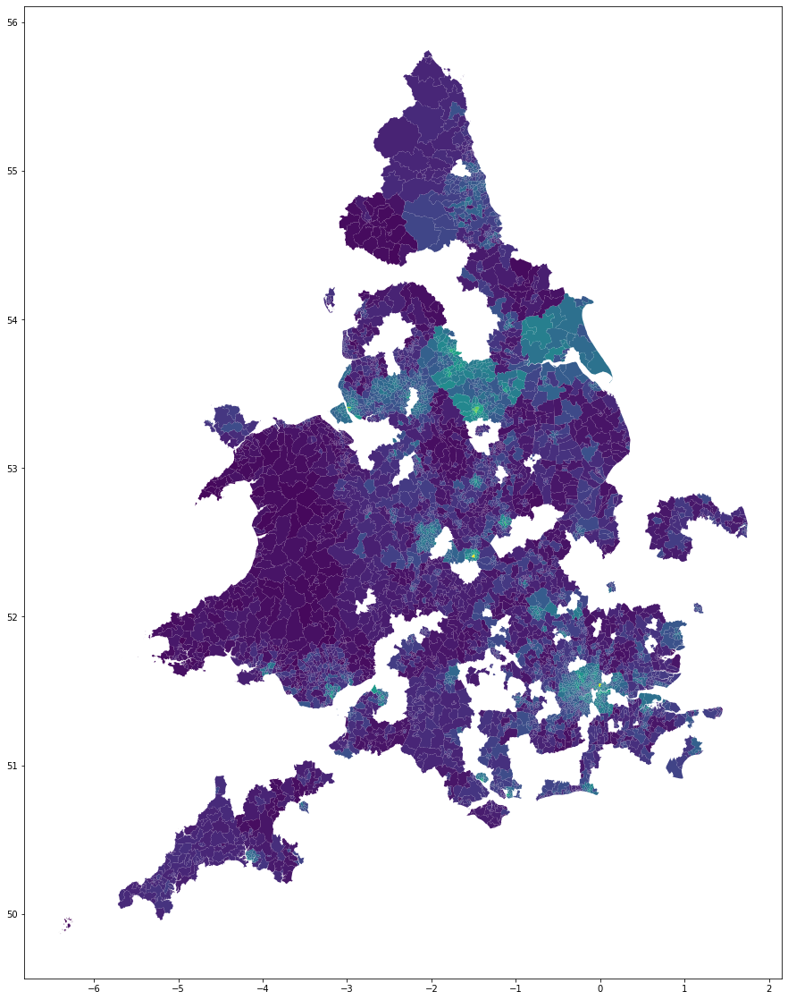

In [145]:
full_ward_shp.plot(column='total_population', figsize=(20,20))

In [ ]:
# Set package configurations and imports
# Geocode address as point, return lat-lon
# Import boundary shapefiles (wards to start)
# Identify boundary of point (iterate for multiple boundaries)
# Create buffer around point (drive-time via Geoapify?)
# Overlay buffer to boundary, return geodataframe of boundaries
# Merge boundary with boundary attribute file (e.g., population, election results, etc.)
# Generate map
# Generate dataframe, that can converted into JSON for API response

In [172]:
# Package configuration, and starting imports
google_key = os.environ.get('GOOGLE_KEY')
geoapify_key = os.environ.get('GEOAPIFY_KEY')

In [237]:
iso = get_isoline_from_address('N4 2AR, London')

In [240]:
fig, ax = plt.subplots(1,1, figsize=(200,200))
iso[1].boundary.plot(color='darkblue', ax=ax, linewidth=3)
iso[1].plot(color='purple', ax=ax, alpha=0.8)
wards_api_gdf.plot(color='grey', alpha=0.3, figsize=(10,10), ax=ax)

<AxesSubplot:>

In [182]:
location['lat']

51.56481035

In [ ]:
lat, lon = gdf.iloc[0]['lat'], gdf.iloc[0]['lon']
iso = isoline(lat, lon, mode='drive', range=2100)

In [ ]:
poly = geojson_to_geodataframe(iso)

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(15,15))
ward_shp.plot(ax=ax, column='total_pop')
poly.boundary.plot(ax=ax, color='red', zorder=1)

In [147]:
wards_api = requests.get('https://opendata.arcgis.com/datasets/62bfaabbe3e24a359fc36b34d7fe8ac8_0.geojson')

In [152]:
wards_api_gdf = geojson_to_geodataframe(wards_api.json())

<AxesSubplot:>

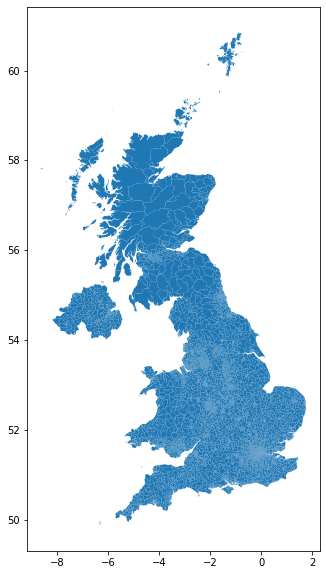

In [170]:
wards_api_gdf.plot(figsize=(10,10))

<AxesSubplot:>

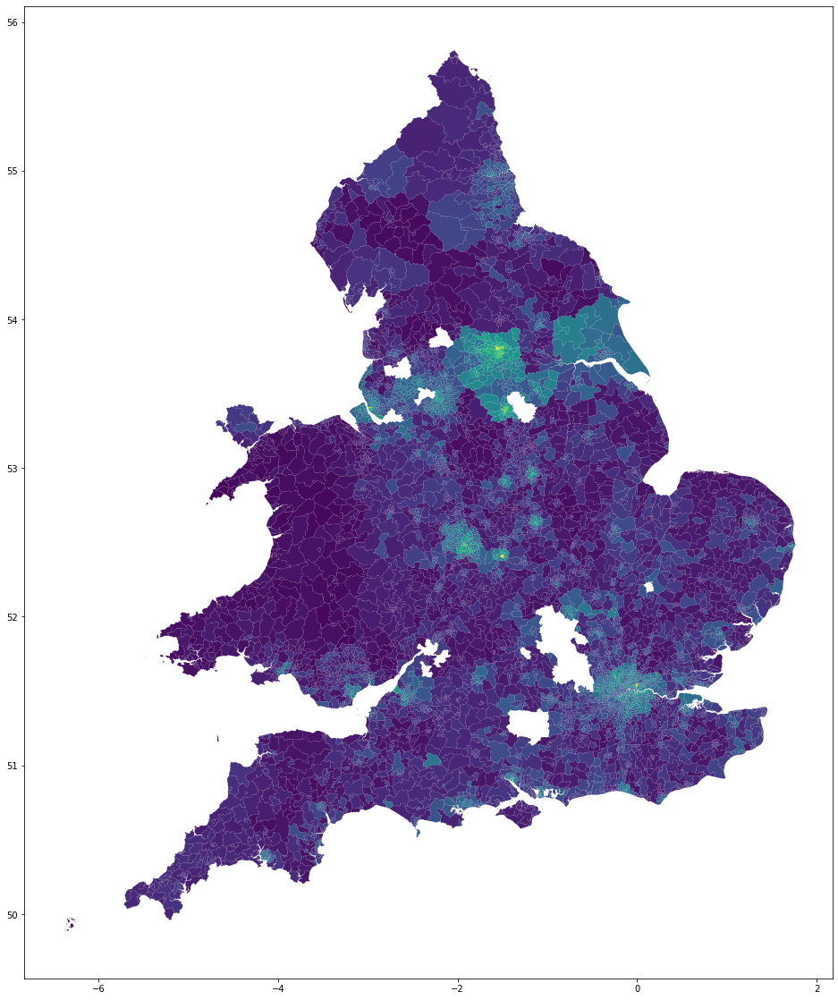

In [157]:
# Could issue be naming/code differences between 2017 and 2020? Maybe include ward names and merge on that, rather than code?
wards_api_gdf.merge(wards_full, left_on='wd20cd',right_on='Ward Code 1', how='inner').plot(column='total_population',
                                                                                          figsize=(20,20))

In [163]:
wards_full.sort_values(by='total_population')

,Ward Code 1,total_population,mean_age,median_age,Under 10,10-17,18-25,26-30,31-35,36-40,41-50,51-60,61-70,71-80,81-90,90+
5344,E05011092,149.0,42.348993,43.0,20.0,13.0,9.0,7.0,11.0,11.0,15.0,20.0,21.0,14.0,8.0,149.0
5343,E05011091,204.0,42.107843,39.0,16.0,18.0,22.0,21.0,16.0,13.0,21.0,20.0,30.0,19.0,8.0,204.0
5346,E05011094,273.0,32.985348,29.0,17.0,11.0,70.0,47.0,28.0,27.0,35.0,18.0,9.0,7.0,4.0,273.0
3781,E05009310,292.0,34.486301,33.0,23.0,10.0,40.0,52.0,48.0,26.0,42.0,31.0,19.0,1.0,0.0,292.0
3775,E05009292,306.0,33.751634,31.0,14.0,9.0,66.0,60.0,39.0,31.0,53.0,20.0,9.0,2.0,3.0,306.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5642,E05011394,32983.0,29.856653,27.0,6181.0,5319.0,4114.0,2566.0,2540.0,2407.0,3952.0,2718.0,1684.0,917.0,585.0,32983.0
669,E05000889,33468.0,26.310087,23.0,730.0,728.0,21080.0,4339.0,2106.0,1269.0,1239.0,867.0,629.0,309.0,172.0,33468.0
5650,E05011403,35900.0,25.968747,23.0,1944.0,1372.0,20684.0,4479.0,2100.0,1395.0,1603.0,1070.0,692.0,370.0,191.0,35900.0
384,E05000492,36666.0,30.514946,29.0,3377.0,2199.0,7789.0,7598.0,5400.0,3188.0,3054.0,2152.0,1107.0,545.0,257.0,36666.0
